# 0.Import modules

In [14]:
import sys
import os
from pathlib import Path

import gc
import warnings

from datetime import datetime
from glob import glob

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as se
import scipy.stats as stats

from ydata_profiling import ProfileReport

import ipywidgets as widgets

from tqdm import tqdm

In [2]:

# Set view options
se.set(style='white', context='notebook', rc={'figure.figsize': (14, 10)})

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

warnings.filterwarnings('ignore')

%matplotlib inline

#   1.Business Understanding

In Kaggle's GoDaddy Microbusiness Density Forecasting competition, we are given 3135 time series of length 39. These time series are 39 month observations from 3135 unique USA counties between the months of August 2019 thru October 2022 inclusive. We are asked to predict microbusiness density for the next 8 months which are November 2022 thru June 2023 inclusive. Microbusiness density is the number of microbusinesses per 100 adults in specific county. We are asked to make 25080 predictions = 3135 * 8 and the public LB is the evaluation of 3135 predictions for the most recent month using SMAPE metric. The private LB is the evaluation of predictions after current month.


# 2.Data Understanding

## 2.1. Load data

1. train.csv - the training set

    1.1 row_id - An ID code for the row.

    1.2 cfips - A unique identifier for each county using the Federal Information Processing System. The first two digits correspond to the state FIPS code, while the following 3 represent the county.

    1.3 county_name - The written name of the county.

    1.4 state_name - The name of the state.

    1.5 first_day_of_month - The date of the first day of the month.

    1.6 microbusiness_density - Microbusinesses per 100 people over the age of 18 in the given county. This is the target variable. The population figures used to calculate the density are on a two-year lag due to the pace of update provided by the U.S. Census Bureau, which provides the underlying population data annually. 2021 density figures are calculated using 2019 population figures, etc.
    
    1.7 active - The raw count of microbusinesses in the county. Not provided for the test set.

2. revealed_test.csv - the new part of train set. The same scheme as train.csv

3. census_starter.csv Examples of useful columns from the Census Bureau's American Community Survey (ACS) at data.census.gov. The percentage fields were derived from the raw counts provided by the ACS. All fields have a two year lag to match what information was avaiable at the time a given microbusiness data update was published.

    3.1 pct_bb_[year] - The percentage of households in the county with access to broadband of any type. Derived from ACS table B28002: PRESENCE AND TYPES OF INTERNET SUBSCRIPTIONS IN HOUSEHOLD.

    3.2 cfips - The CFIPS code.

    3.3 pct_college_[year] - The percent of the population in the county over age 25 with a 4-year college degree. Derived from ACS table S1501: EDUCATIONAL ATTAINMENT.

    3.4 pct_foreign_born_[year] - The percent of the population in the county born outside of the United States. Derived from ACS table DP02: SELECTED SOCIAL CHARACTERISTICS IN THE UNITED STATES.

    3.5 pct_it_workers_[year] - The percent of the workforce in the county employed in information related industries. Derived from ACS table S2405: INDUSTRY BY OCCUPATION FOR THE CIVILIAN EMPLOYED POPULATION 16 YEARS AND OVER.
    3.6 median_hh_inc_[year] - The median household income in the county. Derived from ACS table S1901: INCOME IN THE PAST 12 MONTHS (IN 2021 INFLATION-ADJUSTED DOLLARS).

4. test.csv Metadata for the submission rows. This file will remain unchanged throughout the competition.

    4.1 row_id - An ID code for the row.

    4.2 cfips - A unique identifier for each county using the Federal Information Processing System. The first two digits correspond to the state FIPS code, while the following 3 represent the county.

    4.3 first_day_of_month - The date of the first day of the month.

5. sample_submission.csv A valid sample submission. This file will remain unchanged throughout the competition.

    5.1 row_id - An ID code for the row.
    
    5.2 microbusiness_density - The target variable.

In [3]:
#Paths
DATA_PATH = Path("../data")
DATA_PROCESSED_PATH = DATA_PATH / "processed"

In [4]:
train = pd.read_csv(DATA_PATH / "raw/train.csv")
train_revealed = pd.read_csv(DATA_PATH / "raw/revealed_test.csv")

submission_template = pd.read_csv(DATA_PATH / "raw/test.csv")
census = pd.read_csv(DATA_PATH / "raw/census_starter.csv")
submission_example = pd.read_csv(DATA_PATH / "raw/sample_submission.csv")

train = pd.concat([train, train_revealed])

train['ds'] = pd.to_datetime(train['first_day_of_month'])
train['year'] = train['ds'].dt.year
train['month'] = train['ds'].dt.month

## 2.2 Basic EDA

In [5]:
train.head()

,row_id,cfips,county,state,first_day_of_month,microbusiness_density,active,ds,year,month
0,1001_2019-08-01,1001,Autauga County,Alabama,2019-08-01,3.007682,1249,2019-08-01,2019,8
1,1001_2019-09-01,1001,Autauga County,Alabama,2019-09-01,2.884870,1198,2019-09-01,2019,9
2,1001_2019-10-01,1001,Autauga County,Alabama,2019-10-01,3.055843,1269,2019-10-01,2019,10
3,1001_2019-11-01,1001,Autauga County,Alabama,2019-11-01,2.993233,1243,2019-11-01,2019,11
4,1001_2019-12-01,1001,Autauga County,Alabama,2019-12-01,2.993233,1243,2019-12-01,2019,12


In [6]:
census.head()

,pct_bb_2017,pct_bb_2018,pct_bb_2019,pct_bb_2020,pct_bb_2021,cfips,pct_college_2017,pct_college_2018,pct_college_2019,pct_college_2020,pct_college_2021,pct_foreign_born_2017,pct_foreign_born_2018,pct_foreign_born_2019,pct_foreign_born_2020,pct_foreign_born_2021,pct_it_workers_2017,pct_it_workers_2018,pct_it_workers_2019,pct_it_workers_2020,pct_it_workers_2021,median_hh_inc_2017,median_hh_inc_2018,median_hh_inc_2019,median_hh_inc_2020,median_hh_inc_2021
0,76.6,78.9,80.6,82.7,85.5,1001,14.5,15.9,16.1,16.7,16.4,2.1,2.0,2.3,2.3,2.1,1.3,1.1,0.7,0.6,1.1,55317,58786.0,58731,57982.0,62660.0
1,74.5,78.1,81.8,85.1,87.9,1003,20.4,20.7,21.0,20.2,20.6,3.2,3.4,3.7,3.4,3.5,1.4,1.3,1.4,1.0,1.3,52562,55962.0,58320,61756.0,64346.0
2,57.2,60.4,60.5,64.6,64.6,1005,7.6,7.8,7.6,7.3,6.7,2.7,2.5,2.7,2.6,2.6,0.5,0.3,0.8,1.1,0.8,33368,34186.0,32525,34990.0,36422.0
3,62.0,66.1,69.2,76.1,74.6,1007,8.1,7.6,6.5,7.4,7.9,1.0,1.4,1.5,1.6,1.1,1.2,1.4,1.6,1.7,2.1,43404,45340.0,47542,51721.0,54277.0
4,65.8,68.5,73.0,79.6,81.0,1009,8.7,8.1,8.6,8.9,9.3,4.5,4.4,4.5,4.4,4.5,1.3,1.4,0.9,1.1,0.9,47412,48695.0,49358,48922.0,52830.0


In [7]:
submission_example.head()

,row_id,microbusiness_density
0,1001_2022-11-01,3.817671
1,1003_2022-11-01,3.817671
2,1005_2022-11-01,3.817671
3,1007_2022-11-01,3.817671
4,1009_2022-11-01,3.817671


In [8]:
submission_template.head()

,row_id,cfips,first_day_of_month
0,1001_2022-11-01,1001,2022-11-01
1,1003_2022-11-01,1003,2022-11-01
2,1005_2022-11-01,1005,2022-11-01
3,1007_2022-11-01,1007,2022-11-01
4,1009_2022-11-01,1009,2022-11-01


In [9]:
submission_template.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25080 entries, 0 to 25079
Data columns (total 3 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   row_id              25080 non-null  object
 1   cfips               25080 non-null  int64 
 2   first_day_of_month  25080 non-null  object
dtypes: int64(1), object(2)
memory usage: 587.9+ KB


In [8]:
profile = ProfileReport(train, title="Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
profile = ProfileReport(census, title="Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 2.1 Missing Values

In [ ]:
df.isnull().mean() * 100

Day                                 0.0
Customer Effort Score               0.0
Satisfaction Rate                   0.0
Reopen Rate                         0.0
Entities number                     0.0
Average Calendar Resolution Time    0.0
Contacts per Entity                 0.0
Average Reassigns Number            0.0
df_index                            0.0
dayofweek                           0.0
dtype: float64

<AxesSubplot:>

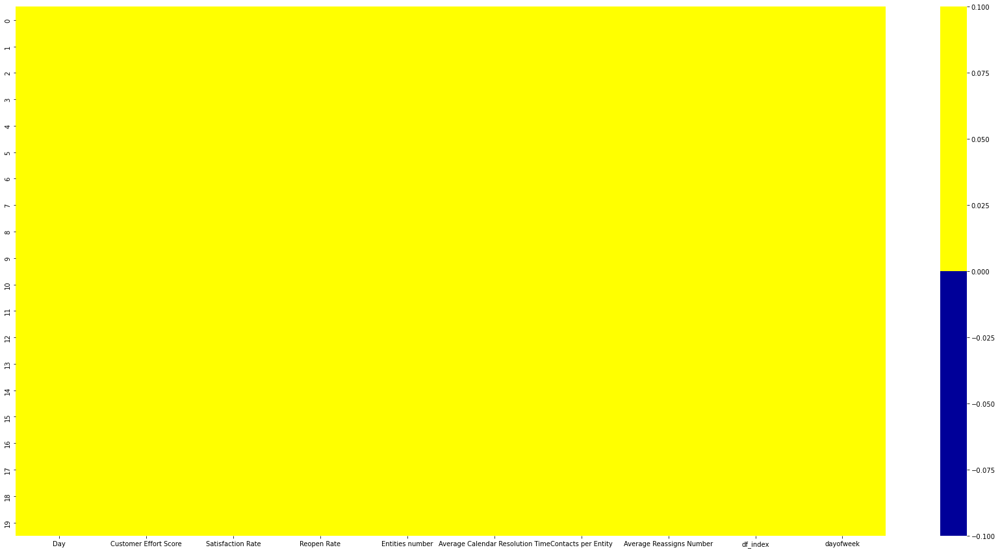

In [ ]:
cols = df.columns[:]
colours = [
    "#000099",
    "#ffff00",
]  # specify the colours - yellow is missing. blue is not missing.
plt.figure(figsize=(30, 15))
se.heatmap(df.iloc[:20][cols].isnull(), cmap=se.color_palette(colours))

## 2.2 Outliers


In [10]:
lag = 1
train[f'mbd_lag_{lag}'] = train.groupby('cfips')['microbusiness_density'].shift(lag).bfill()
train['dif'] = (train['microbusiness_density'] / train[f'mbd_lag_{lag}']).fillna(1).clip(0, None) - 1
train.loc[(train[f'mbd_lag_{lag}']==0), 'dif'] = 0
train.loc[(train[f'microbusiness_density']>0) & (train[f'mbd_lag_{lag}']==0), 'dif'] = 1
train['dif'] = train['dif'].abs()
train.groupby('dcount')['dif'].sum().plot()

KeyError: 'dcount'

## 2.3  Remain operations

In [ ]:
df.nunique()


Day                                 546
Customer Effort Score               441
Satisfaction Rate                   459
Reopen Rate                         367
Entities number                     282
Average Calendar Resolution Time    533
Contacts per Entity                 125
Average Reassigns Number             46
df_index                            546
dayofweek                             7
dtype: int64

In [ ]:
df.describe()


,Customer Effort Score,Satisfaction Rate,Reopen Rate,Entities number,Average Calendar Resolution Time,Contacts per Entity,Average Reassigns Number,df_index,dayofweek
count,546.000000,546.000000,546.000000,546.000000,546.000000,546.000000,546.000000,546.000000,546.000000
mean,0.922484,0.956961,0.012277,377.423077,129.124194,2.483755,0.142582,272.500000,3.000000
std,0.072582,0.032134,0.018849,240.557156,172.232092,0.403765,0.110428,157.760895,2.001834
min,0.250000,0.656250,0.000000,1.000000,16.390000,1.220000,0.000000,0.000000,0.000000
25%,0.918414,0.954756,0.003835,35.250000,80.925000,2.400000,0.110000,136.250000,1.000000
50%,0.934635,0.962368,0.009416,480.500000,97.770000,2.500000,0.130000,272.500000,3.000000
75%,0.948833,0.969642,0.013937,558.000000,124.785000,2.580000,0.160000,408.750000,5.000000
max,1.000000,1.000000,0.200000,806.000000,3142.080000,5.960000,1.670000,545.000000,6.000000


In [ ]:
df.dtypes


Day                                 datetime64[ns]
Customer Effort Score                      float64
Satisfaction Rate                          float64
Reopen Rate                                float64
Entities number                              int64
Average Calendar Resolution Time           float64
Contacts per Entity                        float64
Average Reassigns Number                   float64
df_index                                     int64
dayofweek                                    int64
dtype: object

In [ ]:
df.duplicated().describe()


count       546
unique        1
top       False
freq        546
dtype: object

## 2.4 Results

Часть 1

1. Нет пропусков в данных
2. Correlation
Customer Effort Score is higly correlated with Satisfaction rate
Reopen Rate is higly correlated with Customer Effort Score
Average Calendar Resolution Time is higly correlated with Customer Effort Score
Contact per Entity is higly correlated with Reopen rate
Average Reassigns Number is higly correlated with Satisfaction rate
3. Customer Effort Score - 10% наивысших оценок и длинный хвост в сторону убывания
4. Сильное падение почти по всем метрикам на выходных! Почему так происходит и что с этим делать?
5. Reopen Rate - 22% zeros
6. Average Reassigns Number - 7% zeros
7. Sutisfaction rate - 5% наивысших оценок и длинный хвост в сторону убывания
8. Reopen Rate - большой объем выбросов - коэффициент вариации 153%
9. Entities Number - квази бимодальное распредление - скорее всего связано с разделением на рабочие и нерабочие/выходные дни
10. Average Calendar Resolution Time - большое колличество выбросов - коэффициент вариации 133% нужно отдельно обрабатывать выбросы
11. Contacts per Entity - есть слабо выраженная бимодальноесть, возможно связано с рабочими/выходными днями
12. Average Reassigns Number - большое колличество выбросов
13. Отчетливо виден тренд роста Entities Number в течение полутора лет
14. Contacts per Entity - в последние 1-2 месяца резкое падение, чем вызвано?
15. Average Reassigns Number лучше корелирует с целевыми метриками чем Contact per Entity

Часть 2

1. Сильно различаются распределения метрик в выходные и буднии дни
2. На выходных обычно ставят лучшие оценки и худщие оценки по Customer Efforts Score and Satisfaction Rate
3. На выходных Reopen Rate имеет большое колличество нулей и с другой стороны большое колличество больших значений
4. Бимодальность в Contact per Entity связана со значительным свдигом в распределение примерно в середнине мая 2022
5. Entities Number имеют различные распределения для выходных и будних дней
6. Average Reassign Number - много нулей в выходные, различие в распределение значений
7. 


# 3.Basic Data Preparetion

List of changes:

3.1. Basic operations  <br>
- посмотреть основную статистику без учета выходных дней так как в выходные обычно сильно меньше данных - Done
- посмотреть основную статистику только на выходных днях (возможно стоит отдельно обрабатыватьих) - Done
- отдельно посмотреть слой с худщими показателями - есть ли причинно следственная связь между параметрами
- EDA после препроцессинага


3.2 Handling missing data <br>
3.3 Encoding <br>
3.4 Inconsist data detection <br>
3.5 Unnecessary data detection: Uninformative / Repetitive /  Irrelevant <br>
3.6 Outliers <br>
3.7 Features normalization <br>

In [11]:
train_mod = train.copy()

## 3.1 Basic operations

In [12]:
#Get basic features
train_mod = train_mod.sort_values(['cfips','row_id']).reset_index(drop=True)

train_mod['first_day_of_month'] = pd.to_datetime(train_mod["first_day_of_month"])
train_mod['county'] = train_mod.groupby('cfips')['county'].ffill()
train_mod['state'] = train_mod.groupby('cfips')['state'].ffill()
train_mod["year"] = train_mod["first_day_of_month"].dt.year
train_mod["month"] = train_mod["first_day_of_month"].dt.month
train_mod["dcount"] = train_mod.groupby(['cfips'])['row_id'].cumcount()
train_mod['county_i'] = (train_mod['county'] + train_mod['state']).factorize()[0]
train_mod['state_i'] = train_mod['state'].factorize()[0]

<AxesSubplot:xlabel='dcount'>

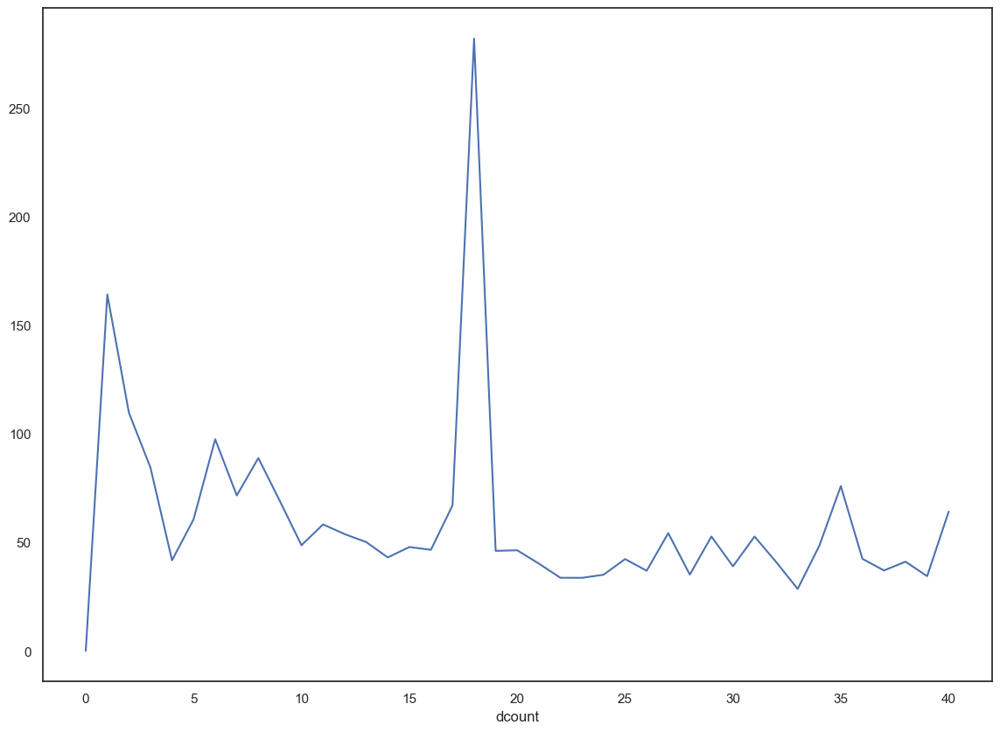

In [13]:
lag = 1
train_mod[f'mbd_lag_{lag}'] = train_mod.groupby('cfips')['microbusiness_density'].shift(lag).bfill()
train_mod['dif'] = (train_mod['microbusiness_density'] / train_mod[f'mbd_lag_{lag}']).fillna(1).clip(0, None) - 1
train_mod.loc[(train_mod[f'mbd_lag_{lag}']==0), 'dif'] = 0
train_mod.loc[(train_mod[f'microbusiness_density']>0) & (train_mod[f'mbd_lag_{lag}']==0), 'dif'] = 1
train_mod['dif'] = train_mod['dif'].abs()
train_mod.groupby('dcount')['dif'].sum().plot()

In [15]:
outliers = []
cnt = 0
for o in tqdm(train_mod.cfips.unique()):
    indices = (train_mod['cfips']==o)
    tmp = train_mod.loc[indices].copy().reset_index(drop=True)
    var = tmp.microbusiness_density.values.copy()
    for i in range(37, 2, -1):
        thr = 0.20*np.mean(var[:i])
        difa = abs(var[i]-var[i-1])
        if (difa>=thr):
            var[:i] *= (var[i]/var[i-1])
            outliers.append(o)
            cnt+=1
    var[0] = var[1]*0.99
    train_mod.loc[indices, 'microbusiness_density'] = var   
outliers = np.unique(outliers)
len(outliers), cnt

100%|██████████| 3135/3135 [00:05<00:00, 598.54it/s]


(481, 732)

<AxesSubplot:xlabel='dcount'>

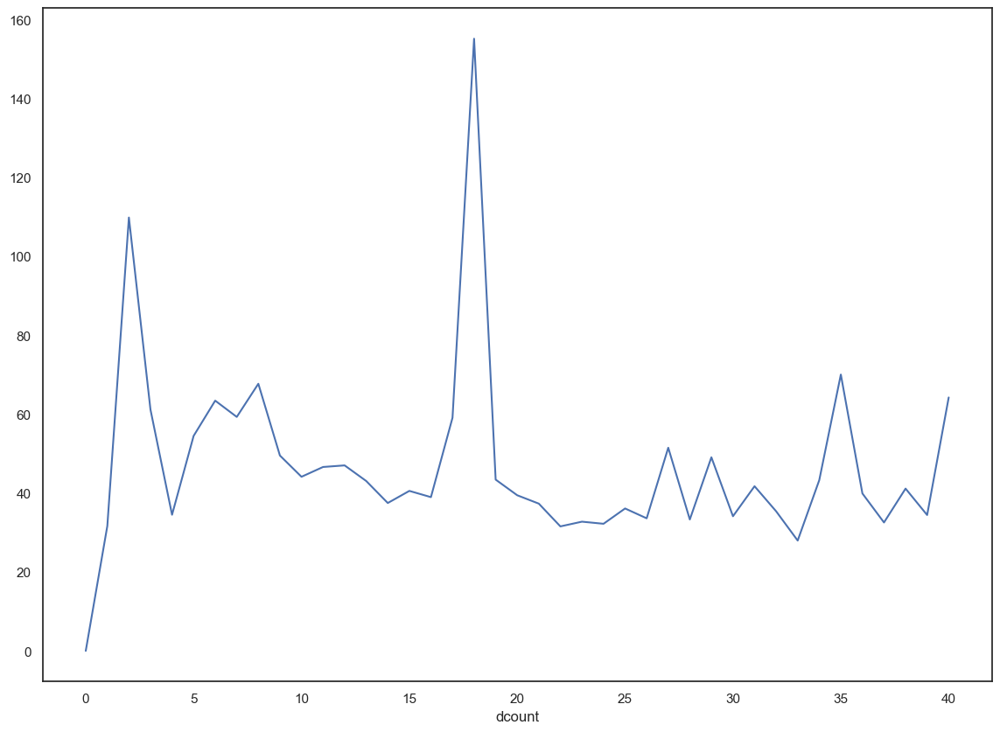

In [16]:
lag = 1
train_mod[f'mbd_lag_{lag}'] = train_mod.groupby('cfips')['microbusiness_density'].shift(lag).bfill()
train_mod['dif'] = (train_mod['microbusiness_density'] / train_mod[f'mbd_lag_{lag}']).fillna(1).clip(0, None) - 1
train_mod.loc[(train_mod[f'mbd_lag_{lag}']==0), 'dif'] = 0
train_mod.loc[(train_mod[f'microbusiness_density']>0) & (train_mod[f'mbd_lag_{lag}']==0), 'dif'] = 1
train_mod['dif'] = train_mod['dif'].abs()
train_mod.groupby('dcount')['dif'].sum().plot()

In [17]:
train_mod.head()

,row_id,cfips,county,state,first_day_of_month,microbusiness_density,active,ds,year,month,mbd_lag_1,dif,dcount,county_i,state_i
0,1001_2019-08-01,1001,Autauga County,Alabama,2019-08-01,2.856021,1249,2019-08-01,2019,8,2.856021,0.000000,0,0,0
1,1001_2019-09-01,1001,Autauga County,Alabama,2019-09-01,2.884870,1198,2019-09-01,2019,9,2.856021,0.010101,1,0,0
2,1001_2019-10-01,1001,Autauga County,Alabama,2019-10-01,3.055843,1269,2019-10-01,2019,10,2.884870,0.059265,2,0,0
3,1001_2019-11-01,1001,Autauga County,Alabama,2019-11-01,2.993233,1243,2019-11-01,2019,11,3.055843,0.020489,3,0,0
4,1001_2019-12-01,1001,Autauga County,Alabama,2019-12-01,2.993233,1243,2019-12-01,2019,12,2.993233,0.000000,4,0,0


In [18]:
train.head()

,row_id,cfips,county,state,first_day_of_month,microbusiness_density,active,ds,year,month,mbd_lag_1,dif
0,1001_2019-08-01,1001,Autauga County,Alabama,2019-08-01,3.007682,1249,2019-08-01,2019,8,3.007682,0.000000
1,1001_2019-09-01,1001,Autauga County,Alabama,2019-09-01,2.884870,1198,2019-09-01,2019,9,3.007682,0.040833
2,1001_2019-10-01,1001,Autauga County,Alabama,2019-10-01,3.055843,1269,2019-10-01,2019,10,2.884870,0.059265
3,1001_2019-11-01,1001,Autauga County,Alabama,2019-11-01,2.993233,1243,2019-11-01,2019,11,3.055843,0.020489
4,1001_2019-12-01,1001,Autauga County,Alabama,2019-12-01,2.993233,1243,2019-12-01,2019,12,2.993233,0.000000


## 3.2 Handling missing data

## 3.3 Encoding

## 3.4 Inconsist data detection

## 3.5 Unnecessary data detection: Uninformative / Repetitive /  Irrelevant


## 3.6 Outliers

In [16]:
# Zscore
outlier_threshold = 3
dfmod_zscoremin = ((dfmod - dfmod.mean()) / dfmod.std()).min()
print(dfmod_zscoremin.where(dfmod_zscoremin < -outlier_threshold).dropna())

Customer Effort Score   -9.265180
Satisfaction Rate       -9.357980
Contacts per Entity     -3.129927
dtype: float64


In [17]:
outlier_threshold = 3
dfmod_zscoremax = ((dfmod - dfmod.mean()) / dfmod.std()).max()
print(dfmod_zscoremax.where(dfmod_zscoremax > outlier_threshold).dropna())

Reopen Rate                          9.959252
Average Calendar Resolution Time    17.493580
Contacts per Entity                  8.609579
Average Reassigns Number            13.831857
dtype: float64


<AxesSubplot:>

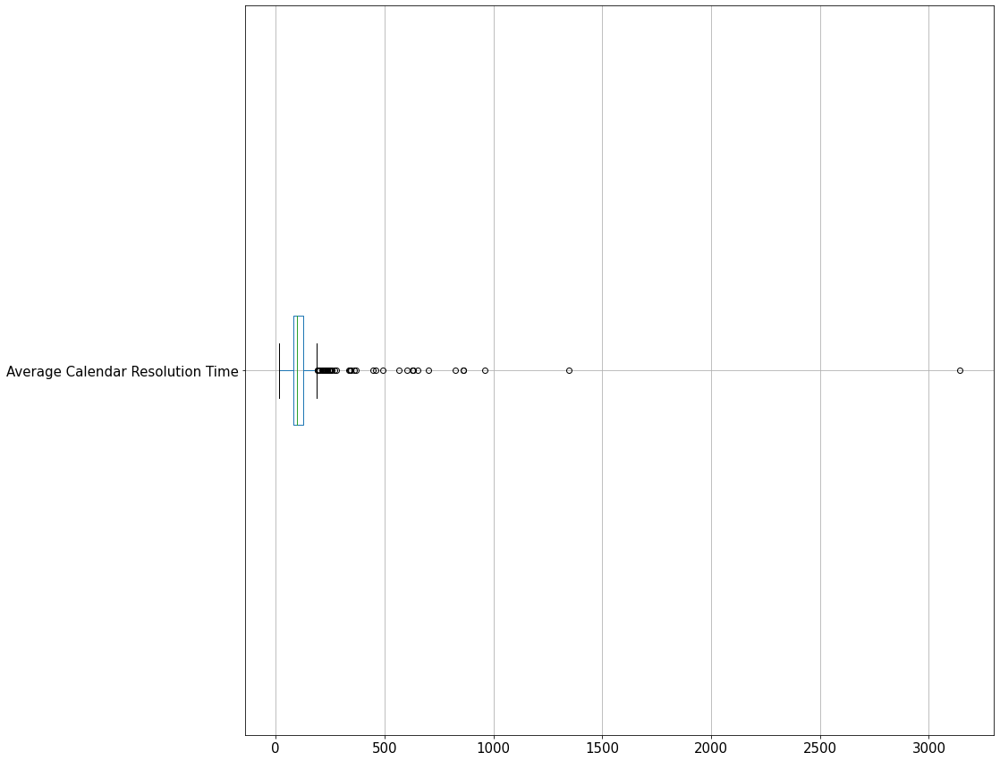

In [15]:
# box plot
plt.figure(figsize=(15, 15))
dfmod.boxplot(column="Average Calendar Resolution Time", fontsize=15, vert=False)

In [405]:
# Грубый подход - убираем всё что больше предельного значения

outlier_threshold = 2

z = np.abs(stats.zscore(dfmod))
z_work = np.abs(stats.zscore(dfmod_work))
z_hold = np.abs(stats.zscore(dfmod_hold))

dfmod1 = dfmod[(z < outlier_threshold).all(axis=1)]
dfmod_work1 = dfmod_work[(z_work < outlier_threshold).all(axis=1)]
dfmod_hold1 = dfmod_hold[(z_hold < outlier_threshold).all(axis=1)]

In [404]:
profile = ProfileReport(dfmod1, title="Pandas Profiling Report")
profile.to_widgets()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

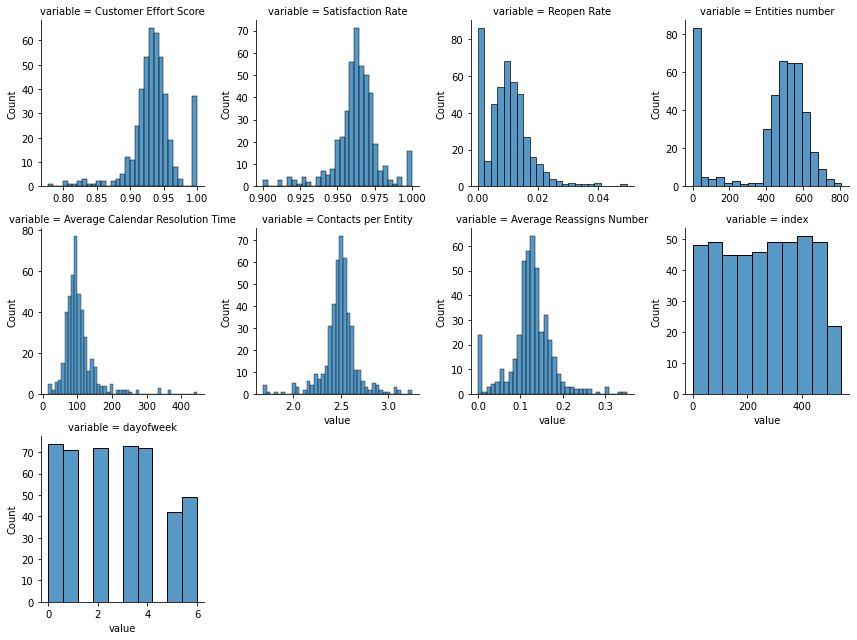

In [50]:
numerical_columns_mod = list(dfmod_o.columns)

histograms_numeric_columns(dfmod_o, numerical_columns_mod)


## 3.7 Features normalization

In [43]:
# Make train and test data

"""

X = dfmod\
        .drop(
            ['Average Reassigns Number', 'Day'], 
            axis=1
        )
y = dfmod['Average Reassigns Number']

"""

In [39]:
"""
# Scaling
def min_max_scaling(df):
    # copy the dataframe
    df_norm = df.copy()
    # apply min-max scaling
    for column in df_norm.columns:
        df_norm[column] = (df_norm[column] - df_norm[column].min()) / (df_norm[column].max() - df_norm[column].min())
        
    return df_norm

X = min_max_scaling(X)
"""

,Номер партии,Номер партии_АСУТП,Номер плавки,Номер рулона,Длина_1,Длина_2,Длина_3,Длина_4,Длина_5,Углерод_начало,Длина_Обезуглероживание,Толщина_средняя,Длина_ГП,Длина_МС,Длина_Н,Азот_конец,Азот_начало,Азот_среднее,Кислород_начало,N,Al,Номер_бригады,Длина__м,ЗВО,CO_Этап2_зона1,CO_Этап2_зона2,CO_Этап2_зона3,CO_Этап2_зона4,CO2_Этап1,Калиброванное_значение_CO2_Этап2_зона4,Si,Mn,NH3_Этап3_зона3,T_Этап3_зона4,Настройка_датчика_CO2_Этап2_зона4,Кислород_конец,Кислород_среднее,Sn,Средние_магнитные_потери,Коэффициент_свойств_стали,S,Датчик_механических_свойств,Углерод_конец,Скорость_технологической_секции,H2_Этап4_зона1,H2_Этап2_зона1,H2_Этап2_зона2,H2_Этап2_зона3,H2_Этап2_зона4,H2_Этап3_зона1,H2_Этап3_зона2,NH3_Этап3_зона1,NH3_Этап3_зона2,CO_Этап2_зона5,Углерод_среднее,Т_Этап5_зона1,Т_Этап5_зона2,Т_Этап4_зона1,Т_Этап4_зона2,T_Этап1_зона1,T_Этап1_зона2,T_Этап1_зона3,T_Этап1_зона4,T_Этап1_зона5,T_Этап2_зона1,T_Этап2_зона2,T_Этап2_зона3,T_Этап2_зона4,T_Этап2_зона5,T_Этап2_зона6,T_Этап2_зона7,T_Этап3_зона1,T_Этап3_зона2,T_Этап3_зона3,T_в_начале_нормализации,T_в_середине_нормализации_1,T_в_середине_нормализации_2,T_в_конце_нормализации,T_проход_1,T_проход_3,T_проход_5,T_проход_2,T_проход_4,Температура_полосы_на_выходе_реверсивного стана,Ti,Длина_Азотирование,Толщина_МС,Точка_росы_Этап4_зона1,Точка_росы_Этап2_зона2,Точка_росы_Этап2_зона3,T_за_средней_клетью,T_конца_проката,T_рулона,Тренд_температуры_перед_реверсивным_станом,Толщина_перед_смоткой,C,Удельные_потери,F,Cr,Водород_начало,Водород_среднее,CO2_Этап2_зона5,H2_Этап2_зона5,Точка_росы_Этап1_зона1,Точка_росы_Этап1_зона2,CO_Этап1_зона1,CO_Этап1_зона2,H2_Этап1,CO2_Этап2_зона1,CO2_Этап2_зона3,Поступление в технологическую секцию,Выезд из технологической секции,Melubir 6731/LI,Melubir 6733/LI,Melubir 6736/LI,Melubir 6738/LI,Melubir 6739/LI
0,522350,580797,1717428,70,23.28,2214.0,55.600000,5111.880000,121.760000,0.0027,121.120000,25,46.32,120,25.2,0.023,0.022,0.0225,0.091,0.0083,0.028,1,0.016000,3.5,1.73,1.15,0.46,0.21,0.11,-0.020000,3.315,0.14,0.150116,309,0.000000,0.0875,0.08925,0.003,1.04,1,0.005,35.801680,0.0025,68.0,51.69,69.17,68.23,65.46,53.39,36.0,18.704960,0.03,0.96,1.570694,0.0026,747.844480,745.990000,839.960000,839.575520,930.180000,929.640000,909.099920,900.041200,868.47,839.902240,839.900000,840.422080,839.81000,839.197760,839.522240,839.325600,770.44,769.471120,771.61576,1097.4032,1098.0032,1091.0952,902.1128,135.691170,181.605608,199.750038,178.91038,191.527300,100,0.002,3560,0.287,-19.860000,61.004480,59.753280,948.368,922.787048,593.184381,364,2.3,0.055,1.072,0.024,0.11,2.4,1.7,1.22,69.7,0.0,63.680000,0.0,1.6,69.75,0.1,0.06,306083,306127,0,0,1,0,0
1,522350,580797,1717428,70,25.22,2211.0,60.233333,5104.953333,131.906667,0.0027,131.213333,25,47.68,130,27.3,0.023,0.022,0.0225,0.091,0.0083,0.028,1,0.017333,3.5,1.73,1.15,0.46,0.21,0.11,0.821471,3.315,0.14,0.756901,25,0.841471,0.0875,0.08925,0.003,1.04,1,0.005,42.802093,0.0025,68.0,51.69,69.17,68.23,65.46,53.39,36.0,14.925400,0.03,0.96,1.570503,0.0026,747.880000,745.992427,839.962427,839.538787,930.177573,929.640000,909.020000,900.145773,868.47,839.921213,839.908493,840.284853,839.81000,839.181213,839.524227,839.359080,770.44,769.488493,771.83092,1097.4368,1098.0368,1091.0448,902.2472,136.562104,183.547782,200.214333,179.18122,193.175100,100,0.002,3680,0.288,-19.860000,61.035147,59.690293,948.232,922.812952,591.215619,364,2.3,0.055,1.087,0.024,0.11,2.7,1.9,1.22,70.8,0.0,63.680000,0.0,1.6,69.75,0.1,0.06,306083,306127,0,0,1,0,0
2,522350,580797,1717428,70,27.16,2208.0,64.866667,5098.026667,142.053333,0.0027,141.306667,25,49.04,140,29.4,0.023,0.022,0.0225,0.091,0.0083,0.028,1,0.018667,3.5,1.73,1.15,0.46,0.21,0.11,0.889297,3.315,0.14,0.149549,290,0.909297,0.0875,0.08925,0.003,1.04,1,0.005,49.010987,0.0025,68.0,51.69,69.17,68.23,65.46,53.39,36.0,9.393013,0.03,0.96,1.570327,0.0026,747.882613,746.025680,839.980000,839.565280,930.149547,929.633467,909.021307,900.270453,868.47,839.936533,839.971307,840.333067,839.81000,839.196533,839.4139

# 4.Data Understanding after Basic Data Preparetion

# 5.Results

1. 

# 6.Future study

1. 